<a href="https://colab.research.google.com/github/chitreshkr/KaggleProjects/blob/main/Used_Car_Price_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'playground-series-s4e9:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-competitions-data%2Fkaggle-v2%2F76728%2F9057646%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240928%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240928T124112Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3Ddb3cda75a290d7daa7511e81d59fe58606d630060dcae397760f0c4cff52f61301282c5f38ec948d0bd39ee19a95efd5eebd827399541c9358f435d1d66fc51c41b79a589d27c5b22b3c1a3ad40dca8004ba20a5d640151b50d6ab3f2e08ad33a2ac43a6f6fbb69eebec1372ee76760ff1eaae3d0a5a8cf07eb12dcc2228af7c754b1c1d540ab28508840f525684025768acb1ed195f4ffb38d93fa8f566392e31fcbb4918cc6ee303ec1e2ecf371460bf19a60e45604f9336bb5446b453c5ecdc661755f13219f49645dc48d562ffe34a36134c5b28756b2f31c603e9f6cdfc103e92456bf0a07b5209961db6f0b2191bc47034312c65978971f9b88267b174'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 8223535 bytes downloaded
Downloaded and uncompressed: playground-series-s4e9
Data source import complete.


In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
%matplotlib inline
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/playground-series-s4e9/train.csv
/kaggle/input/playground-series-s4e9/sample_submission.csv
/kaggle/input/playground-series-s4e9/test.csv


In [3]:
!pip install dash

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 7.2 MB/s eta 0:00:00


In [4]:
import seaborn as sns
from dash import Dash, html, dcc, callback, Output, Input
import plotly.express as px

# Disable any warnings
import warnings

warnings.filterwarnings("ignore")

In [5]:
import xgboost as xgb
print(xgb.__version__)

2.1.1


In [6]:
!pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 7.1 MB/s eta 0:00:00


In [7]:
import catboost
print(catboost.__version__)

1.2.7


In [8]:
train_df = pd.read_csv('/kaggle/input/playground-series-s4e9/train.csv')

In [9]:
train_df.sample(5)

,id,brand,model,model_year,milage,fuel_type,engine,transmission,ext_col,int_col,accident,clean_title,price
53742,53742,Jeep,Wrangler SE,2006,110000,Gasoline,150.0HP 2.4L 4 Cylinder Engine Gasoline Fuel,M/T,Beige,Beige,None reported,Yes,7900
164486,164486,Ford,Transit-250 Base,2016,11563,Gasoline,310.0HP 3.5L V6 Cylinder Engine Gasoline Fuel,6-Speed A/T,White,Black,None reported,Yes,17500
136744,136744,BMW,328 i xDrive,2011,110000,Gasoline,230.0HP 3.0L Straight 6 Cylinder Engine Gasoli...,Transmission w/Dual Shift Mode,Black,Black,At least 1 accident or damage reported,Yes,15000
30447,30447,INFINITI,QX80 Luxe,2022,15583,Gasoline,5.6 Liter,Automatic,Black,Black,None reported,NaN,59598
33692,33692,Ford,Explorer Platinum,2018,57000,Gasoline,290.0HP 3.5L V6 Cylinder Engine Gasoline Fuel,6-Speed A/T,Blue,Gray,At least 1 accident or damage reported,Yes,33000


In [10]:
train_df.groupby(['brand','model'])['price'].describe().round(1)

count     mean      std      min      25%  \
brand model                                                              
Acura 300 Touring              1.0  19500.0      NaN  19500.0  19500.0   
      330 i xDrive             1.0  28500.0      NaN  28500.0  28500.0   
      335 is                   1.0  17000.0      NaN  17000.0  17000.0   
      ATS 2.0L Turbo Luxury    1.0  10000.0      NaN  10000.0  10000.0   
      Acadia SLE-1             1.0  25625.0      NaN  25625.0  25625.0   
...                            ...      ...      ...      ...      ...   
Volvo XC90 T6 Inscription     32.0  37935.9  14448.0  16500.0  28250.0   
      XC90 T6 Momentum        88.0  35395.1  15432.1   6500.0  25800.0   
      i8 Base                  1.0  38095.0      NaN  38095.0  38095.0   
smart ForTwo Pure              2.0   9497.5    703.6   9000.0   9248.8   
      Nautilus Reserve         1.0  84997.0      NaN  84997.0  84997.0   

                                 50%      75%      max  
brand model                                             
Acura 300 Touring            19500.0  19500.0  19500.0  
      330 i xDrive           28500.0  28500.0  28500.0  
      335 is                 17000.0  17000.0  17000.0  
      ATS 2.0L Turbo Luxury  10000.0  10000.0  10000.0  
      Acadia SLE-1           25625.0  25625.0  25625.0  
...                              ...      ...      ...  
Volvo XC90 T6 Inscription    34500.0  45250.0  76000.0  
      XC90 T6 Momentum       31725.0  40175.0  84000.0  
      i8 Base                38095.0  38095.0  38095.0  
smart ForTwo Pure             9497.5   9746.2   9995.0  
      Nautilus Reserve       84997.0  84997.0  84997.0  

[3555 rows x 8 columns]

In [11]:
train_df.groupby('brand')['price'].describe().round(1)

,count,mean,std,min,25%,50%,75%,max
brand,,,,,,,,
Acura,2282.0,28628.5,30298.6,2000.0,12312.5,20653.5,36552.5,489995.0
Alfa,682.0,51993.1,50643.5,3000.0,29000.0,39900.0,56973.5,649999.0
Aston,238.0,112364.6,213528.0,3850.0,34087.5,67650.0,127922.5,2954083.0
Audi,10887.0,41004.9,57831.9,2000.0,18772.5,29900.0,45950.0,2954083.0
BMW,17028.0,43659.8,57148.7,2000.0,18000.0,31000.0,53825.0,1950995.0
Bentley,1155.0,129272.9,221562.7,2300.0,42000.0,73600.0,145000.0,2954083.0
Bugatti,7.0,169600.0,82980.5,67900.0,90450.0,220000.0,229450.0,259500.0
Buick,940.0,29617.8,26834.8,3200.0,18000.0,26288.0,34582.8,449991.0
Cadillac,4674.0,45659.1,107062.0,2000.0,18000.0,30500.0,51700.0,2954083.0


In [12]:
test_df = pd.read_csv('/kaggle/input/playground-series-s4e9/test.csv')
test_df.head()

,id,brand,model,model_year,milage,fuel_type,engine,transmission,ext_col,int_col,accident,clean_title
0,188533,Land,Rover LR2 Base,2015,98000,Gasoline,240.0HP 2.0L 4 Cylinder Engine Gasoline Fuel,6-Speed A/T,White,Beige,None reported,Yes
1,188534,Land,Rover Defender SE,2020,9142,Hybrid,395.0HP 3.0L Straight 6 Cylinder Engine Gasoli...,8-Speed A/T,Silver,Black,None reported,Yes
2,188535,Ford,Expedition Limited,2022,28121,Gasoline,3.5L V6 24V PDI DOHC Twin Turbo,10-Speed Automatic,White,Ebony,None reported,NaN
3,188536,Audi,A6 2.0T Sport,2016,61258,Gasoline,2.0 Liter TFSI,Automatic,Silician Yellow,Black,None reported,NaN
4,188537,Audi,A6 2.0T Premium Plus,2018,59000,Gasoline,252.0HP 2.0L 4 Cylinder Engine Gasoline Fuel,A/T,Gray,Black,None reported,Yes


In [13]:
train_df.isna().sum()

,0
id,0
brand,0
model,0
model_year,0
milage,0
fuel_type,5083
engine,0
transmission,0
ext_col,0
int_col,0


In [14]:
train_df.shape

(188533, 13)

In [15]:
test_df.shape

(125690, 12)

In [16]:
train_df['brand'].value_counts()

,count
brand,
Ford,23088
Mercedes-Benz,19172
BMW,17028
Chevrolet,16335
Audi,10887
Porsche,10612
Land,9525
Toyota,8850
Lexus,8643


In [17]:
!pip install dash

In [18]:
import plotly.graph_objs as go
import plotly.io as pio
import plotly.graph_objs as go


column_to_exclude = ['id','model','milage','engine','int_col','ext_col','transmission','price']

for col in train_df.columns:

    if col in column_to_exclude:
        continue

    value_counts = train_df[col].value_counts()

    fig = go.Figure([go.Bar(x=value_counts.index,y=value_counts.values)])

    fig.update_layout(title = f'Distribution of {col}',
              xaxis_title = f'Unique values in {col}',
              yaxis_title = f'Frequency',
              template = 'plotly'
              )
    fig.show()

In [19]:
for col in test_df.columns:

    if col in column_to_exclude:
        continue

    value_counts = test_df[col].value_counts()

    fig = go.Figure([go.Bar(x=value_counts.index,y=value_counts.values)])

    fig.update_layout(title = f'Distribution of {col}',
              xaxis_title = f'Unique values in {col}',
              yaxis_title = f'Frequency',
              template = 'plotly'
              )
    fig.show()

In [20]:
import plotly.express as px
# Create scatter plot
fig = px.scatter(train_df, x='model', y='price', title="Brand vs Price Scatter Plot")

# Show the figure
fig.show()

In [21]:
for brand in train_df['brand'].unique():
    brand_data = train_df[train_df['brand'] == brand]
    fig.add_trace(go.Scatter(x=brand_data['model'], y=brand_data['price'].round(),
                             mode='markers', name=brand))

# Update layout with dropdown filter
fig.update_layout(
    title="Model vs Price Scatter Plot",
    xaxis_title="Model",
    yaxis_title="Price",
    updatemenus=[{
        'buttons': [
            {'label': 'All Brands', 'method': 'update', 'args': [{'visible': [True] * len(train_df['brand'].unique())}, {'title': 'All Brands'}]},
            *[{'label': brand, 'method': 'update', 'args': [{'visible': [brand == b for b in train_df['brand'].unique()]}, {'title': f'{brand}'}]} for brand in train_df['brand'].unique()]
        ],
        'direction': 'down',
        'showactive': True,
    }]
)

# Show the figure
pio.show(fig)

In [22]:
!pip install plotly

In [23]:
import plotly.offline as py

In [24]:
data = [go.Histogram(x=train_df['price'],marker=dict(color='blue'))]
py.iplot(data)

In [25]:
grouped_data = train_df.groupby('brand')['price'].apply(list)

# Create a list of histogram traces
traces = []
for brand, data in grouped_data.items():
    trace = go.Histogram(x=data, name=brand, marker=dict(colorscale='Viridis'))
    traces.append(trace)

# Create the figure
fig = go.Figure(data=traces)

# Customize the figure (optional)
fig.update_layout(title='Histogram of Price by Brand')

# Display the figure
fig.show()

In [26]:
import plotly.graph_objs as go

# Assuming you have a DataFrame named 'df' with columns 'brand' and 'price'

# Group the data by brand
grouped_data = train_df.groupby('brand')['price'].apply(list)

# Create a list of histogram traces
traces = []
for brand, data in grouped_data.items():
    trace = go.Histogram(x=data, name=brand, marker=dict(colorscale='Viridis'))
    traces.append(trace)

# Create the dropdown menu
dropdown_menu = dict(
    type='dropdown',
    x=1,
    y=1.2,
    buttons=[
        dict(label='All Brands', method='update', args=[{'visible': [True] * len(traces)}]),
        dict(label='Brand1', method='update', args=[{'visible': [True if trace['name'] == 'Brand1' else False for trace in traces]}])
        # Add more buttons for other brands as needed
    ]
)

# Create the figure
fig = go.Figure(data=traces, layout=dict(updatemenus=[dropdown_menu]))

# Customize the figure (optional)
fig.update_layout(title='Histogram of Price by Brand')

# Display the figure
fig.show()

In [27]:
import plotly.graph_objs as go

# Assuming you have a DataFrame named 'train_df' with columns 'brand' and 'price'

# Group the data by brand
grouped_data = train_df.groupby('brand')['price'].apply(list)

# Create a list of histogram traces
traces = []
for brand, data in grouped_data.items():
    trace = go.Histogram(x=data, name=brand, marker=dict(colorscale='Viridis'))
    traces.append(trace)

# Get unique brandsq
unique_brands = train_df['brand'].unique()

# Create the dropdown menu
dropdown_menu = dict(
    type='dropdown',
    x=1,
    y=1.2,
    buttons=[
        dict(label='All Brands', method='update', args=[{'visible': [True] * len(traces)}])
    ] + [
        dict(label=brand, method='update', args=[{'visible': [trace['name'] == brand for trace in traces]}])
        for brand in unique_brands
    ]
)

# Create the figure
fig = go.Figure(data=traces, layout=dict(updatemenus=[dropdown_menu]))

# Customize the figure (optional)
fig.update_layout(title='Histogram of Price by Brand')

# Display the figure
fig.show()

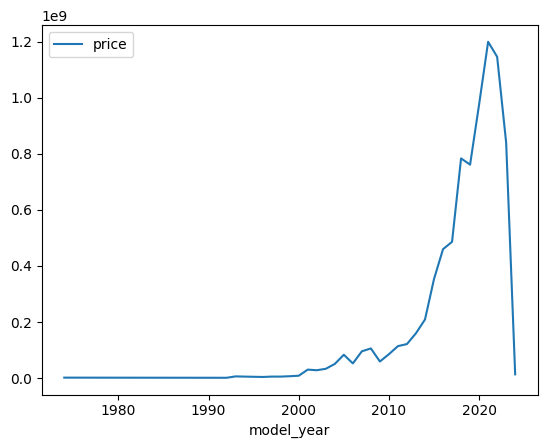

In [28]:
train_df[[x for x in train_df.columns if "price" in x] + ["model_year"]].groupby(
    "model_year"
).sum().plot();

In [29]:
features = train_df.columns[:-1]

In [30]:
train_df['price'].skew().round(2)

20.27

In [31]:
labels = train_df.columns[-1]

In [32]:
features

Index(['id', 'brand', 'model', 'model_year', 'milage', 'fuel_type', 'engine',
       'transmission', 'ext_col', 'int_col', 'accident', 'clean_title'],
      dtype='object')

In [33]:
labels

'price'

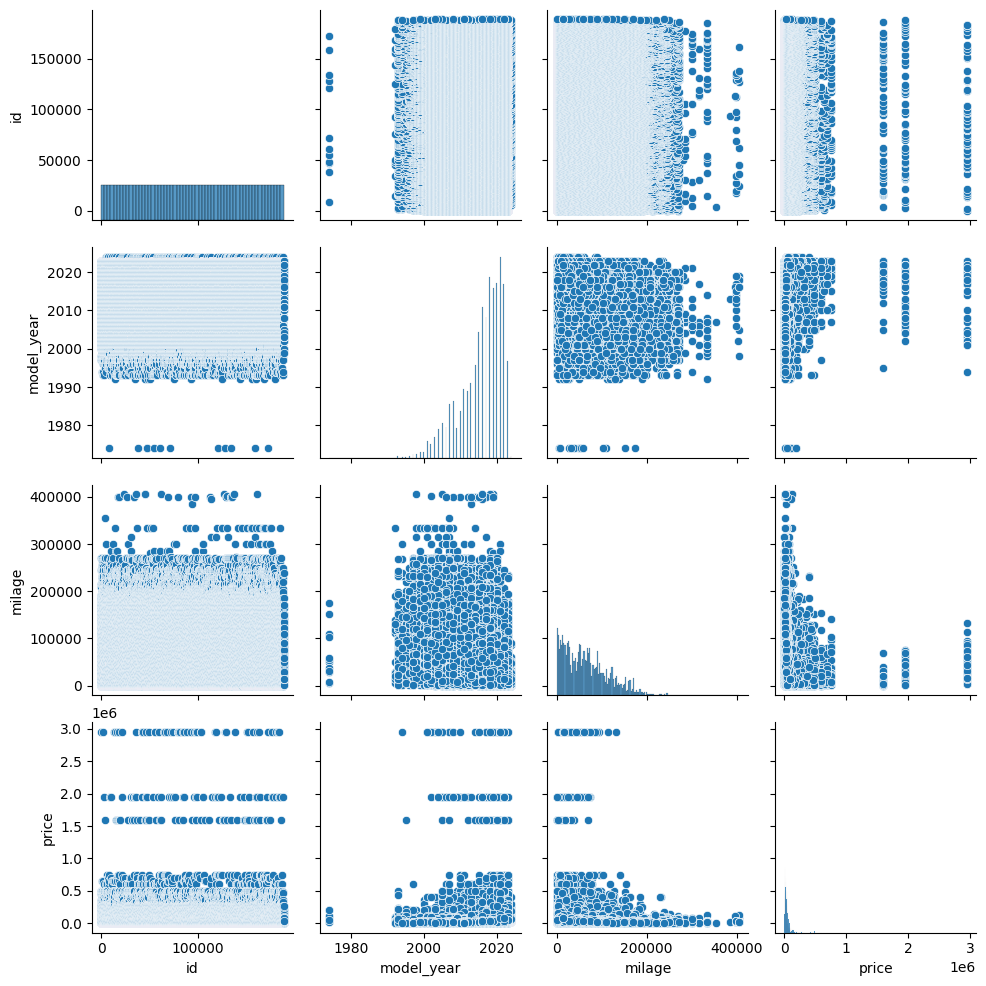

In [34]:
%config InlineBackend.figure_format = 'png'
sns.pairplot(
    train_df
);

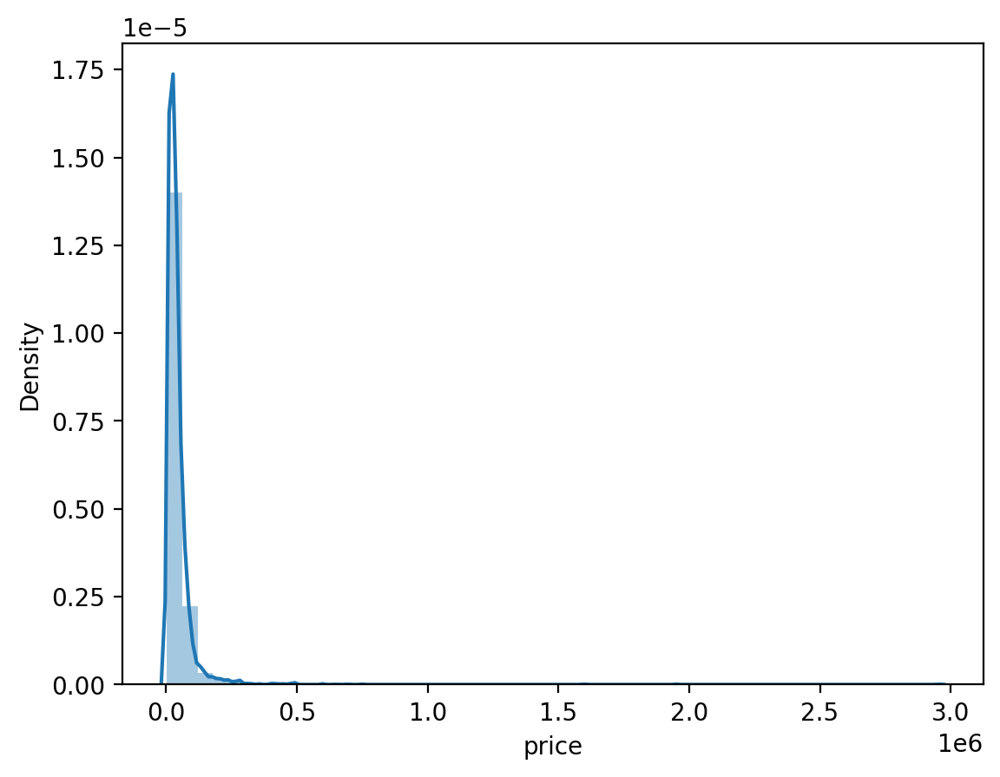

In [35]:
%config InlineBackend.figure_format = 'retina'
sns.distplot(train_df[labels]);

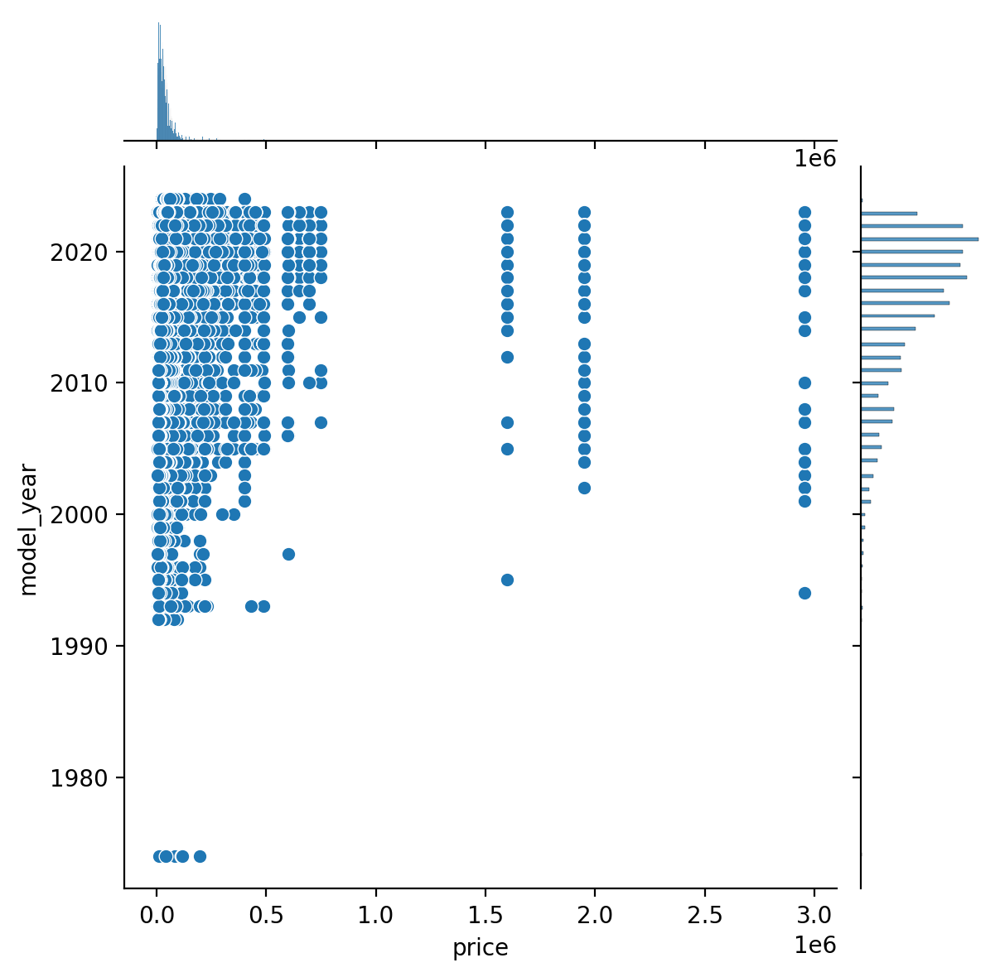

In [36]:
sns.jointplot(x="price", y="model_year", data=train_df, kind="scatter");


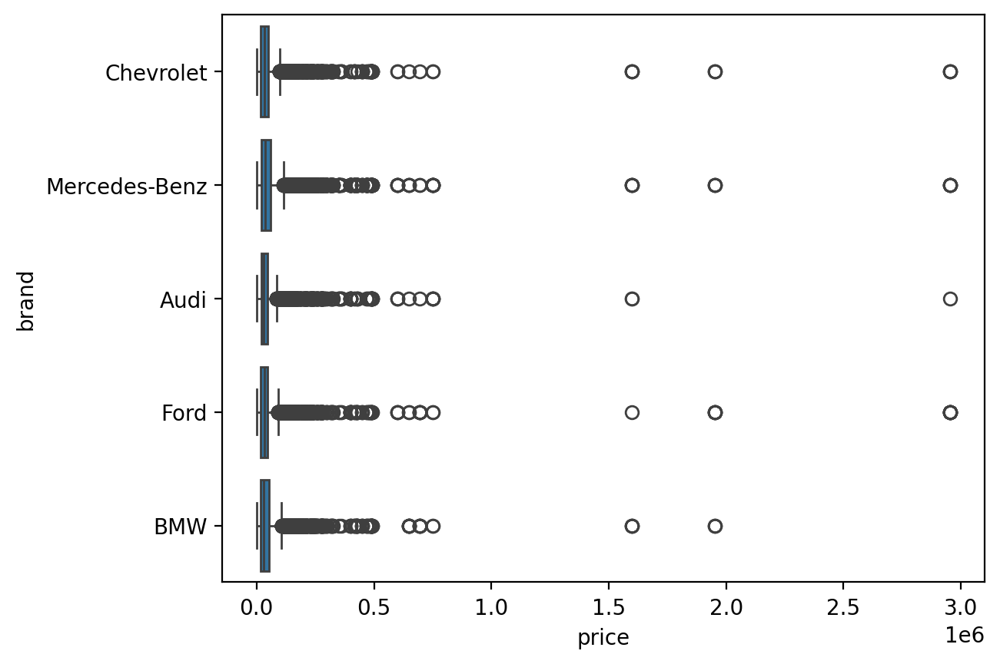

In [37]:
top_brands = (
    train_df["brand"].value_counts().sort_values(ascending=False).head(5).index.values
)
sns.boxplot(
    y="brand",
    x="price",
    data=train_df[train_df["brand"].isin(top_brands)],
    orient="h",
);

In [38]:
import plotly
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot, plot

init_notebook_mode(connected=True)

In [39]:
data = []

# Create a box trace for each genre in our dataset
for brand in train_df.brand.unique():
    data.append(go.Box(y=train_df[train_df.brand == brand].price, name=brand))

# Visualize
iplot(data, show_link=False)

In [45]:
train_df.columns

Index(['id', 'brand', 'model', 'model_year', 'milage', 'fuel_type', 'engine',
       'transmission', 'ext_col', 'int_col', 'accident', 'clean_title',
       'price'],
      dtype='object')

In [49]:
from sklearn.preprocessing import LabelEncoder

category = ['id', 'brand', 'model', 'model_year','fuel_type', 'engine','transmission', 'ext_col', 'int_col', 'accident', 'clean_title']

for col in category:
  le = LabelEncoder()
  le.fit(train_df[col])

# Transform the categorical column to numerical
  train_df[col] = le.transform(train_df[col])

print(train_df)

            id  brand  model  model_year  milage  fuel_type  engine  \
0            0     31    495          16  213000          2     116   
1            1     28    930          11  143250          2     366   
2            2      9   1575          11  136731          1     640   
3            3     16    758          26   19500          2     863   
4            4     36   1077          30    7388          2     259   
...        ...    ...    ...         ...     ...        ...     ...   
188528  188528      8    604          26   49000          2     866   
188529  188529     36    206          27   28600          2     770   
188530  188530     36    223          30   13650          2     921   
188531  188531      3   1471          31   13895          2     512   
188532  188532     43   1028          25   59500          2     364   

        transmission  ext_col  int_col  accident  clean_title  price  
0                 38      312       71         1            0   4200  
1    